In [1]:
%matplotlib inline
import matplotlib as mpl
from matplotlib import pyplot as plt
from matplotlib.patches import Polygon ## for polygons
import baltic as bt
import pandas as pd
from matplotlib.collections import PatchCollection ## for polygons too
from matplotlib import gridspec ## for composite figures
import matplotlib.patheffects as path_effects ## for elegant text
from mpl_toolkits.axes_grid1.colorbar import colorbar

from matplotlib.patches import Patch

import time
import sys
import unicodedata

import numpy as np
import json ## used for importing JSONs
try:
    from StringIO import StringIO as sio
    from cStringIO import StringIO as csio
except ImportError:
    from io import StringIO as sio
    from io import BytesIO as csio
    
def removeDiacritics(string):
    """
    Removes diacritic marks from unicode.
    """
    return unicodedata.normalize('NFKD', string)

try:
    from itertools import product
except ImportError:
    # product is new in v 2.6
    def product(*args, **kwds):
        pools = map(tuple, args) * kwds.get('repeat', 1)
        result = [[]]
        for pool in pools:
            result = [x+[y] for x in result for y in pool]
        for prod in result:
            yield tuple(prod)

ipykernel_launcher.py:16: MatplotlibDeprecationWarning: 
The mpl_toolkits.axes_grid1.colorbar module was deprecated in Matplotlib 3.2 and will be removed two minor releases later. Use matplotlib.colorbar instead.
  app.launch_new_instance()


----

# Creating maps of the climatic and morphological variables

----


## 1. Getting the rasters ready.

Rasters were downloaded from the same w2-5 package that R downloads

In [2]:
rasterbio1=pd.read_csv('../data_files/bio1raster.asc',skiprows=6,sep=' ',header=None,dtype='float')
rasterplotbio1= rasterbio1.mask(np.isclose(rasterbio1.values, -3.400000e+38))

rasterbio4=pd.read_csv('../data_files/bio4raster.asc',skiprows=6,sep=' ',header=None,dtype='float')
rasterplotbio4= rasterbio4.mask(np.isclose(rasterbio4.values, -3.400000e+38))

rasterbio12=pd.read_csv('../data_files/bio12raster.asc',skiprows=6,sep=' ',header=None,dtype='float')
rasterplotbio12= rasterbio12.mask(np.isclose(rasterbio12.values,-3.4000000000000e+38,rtol=0.00001))

rasterbio15=pd.read_csv('../data_files/bio15raster.asc',skiprows=6,sep=' ',header=None,dtype='float')
rasterplotbio15= rasterbio15.mask(np.isclose(rasterbio15.values,-3.4000000000000e+38,rtol=0.00001))

# creating a raster for the aridity index (Bio12/(Bio1+10))
precp=np.array(rasterplotbio12)
PrecSeas=np.array(rasterplotbio15)
temp=np.array(rasterplotbio1)
aridity=precp/(temp+10)

LogAridity=np.log(aridity) # log transform values for aridity
LogPrec=np.log(precp)
LocPrecSeas=np.log(PrecSeas)

\ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
\ipykernel_launcher.py:20: RuntimeWarning: divide by zero encountered in log
\ipykernel_launcher.py:20: RuntimeWarning: invalid value encountered in log
\ipykernel_launcher.py:21: RuntimeWarning: divide by zero encountered in log
\ipykernel_launcher.py:22: RuntimeWarning: divide by zero encountered in log


nrows=3600  
ncols=8640  
xmin=-180  
ymin=-60  
xmax=180  
ymax=90  

In [3]:
xcell=360/8640
ycell=150/3600
print(xcell,ycell)

0.041666666666666664 0.041666666666666664


## 2. Load the palm's tree and filter the data to keep only species in the tree

In [4]:
palms_all_variables=pd.read_csv('../data_files/palms_alltraits_curated_20210210.csv',sep='\t')
palms=pd.read_csv('../data_files/gbifpalms_onlynative_nocen_traitssoils_20200108.csv',sep=',')
palms.columns
treeFileNexus='../data_files/Clean_1_1_MCCT_nexus.nex'
cc=bt.loadNexus(treeFileNexus,absoluteTime=False,tip_regex='_([0-9\-]+)$') ## treeFile here can alternatively be a path to a local file

cc.treeStats()
cc.drawTree()
cc.sortBranches()

tree_spp=[k.name for k in cc.getExternal()]
len(tree_spp)
intree=palms[palms['species'].isin(tree_spp)]
intree

\interactiveshell.py:3049: DtypeWarning: Columns (6,7,8,9,10,12,18,20,21,22,23,24,25,26,27,28,29,32,33,38,51,70) have mixed types. Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)



Tree height: 108.328870
Tree length: 18144.538310
strictly bifurcating tree
annotations present

Numbers of objects in tree: 5099 (2549 nodes and 2550 leaves)



,Unnamed: 0,num,index,species,decimalLatitude,decimalLongitude,Absent_0,Acaulescent,AverageFruitLength_cm,AverageFruitWidth_cm,...,bio10,bio11,bio12,bio13,bio14,bio15,bio16,bio17,bio18,bio19
0,1,0,0,Chamaerops_humilis,36.897130,10.788890,1,2,1.3,1.44,...,256.0,108.0,306.0,66.0,1.0,73.0,161.0,12.0,21.0,142.0
1,2,1,1,Chamaerops_humilis,43.353640,5.418730,1,2,1.3,1.44,...,210.0,61.0,632.0,85.0,16.0,34.0,224.0,84.0,84.0,177.0
2,3,2,2,Hyophorbe_indica,-21.181780,55.535050,0,0,2.3,1.05,...,206.0,152.0,1588.0,260.0,50.0,50.0,685.0,182.0,685.0,222.0
3,4,3,3,Bactris_hatschbachii,-25.144167,-48.306111,1,0,2.05,2,...,234.0,157.0,2048.0,291.0,73.0,41.0,826.0,278.0,767.0,278.0
4,5,4,4,Syagrus_glaucescens,-18.270556,-43.797500,0,0,2.5,2.05,...,207.0,164.0,1423.0,327.0,8.0,86.0,797.0,27.0,558.0,48.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
56366,56934,56933,56933,Trithrinax_campestris,-29.640000,-58.370000,1,0,0.8,1.15,...,255.0,142.0,1097.0,139.0,43.0,33.0,373.0,139.0,318.0,139.0
56367,56935,56934,56934,Chamaedorea_seifrizii,18.078833,-91.329436,0,0,0.8,0.8,...,285.0,235.0,1834.0,320.0,35.0,69.0,868.0,123.0,392.0,191.0
56368,56936,56935,56935,Chamaedorea_elatior,17.808333,-96.125000,0,0,1.5,0.95,...,243.0,192.0,3749.0,695.0,76.0,73.0,1892.0,254.0,818.0,350.0
56369,56937,56936,56936,Livistona_australis,-26.822852,152.888287,1,0,1.7,1.7,...,234.0,140.0,1808.0,265.0,45.0,49.0,783.0,201.0,706.0,254.0


In [5]:
canopy_num={'canopy':1,np.nan:np.nan,'understorey':0}
palms_all_variables['UnderstoreyCanopy_num']=palms_all_variables['UnderstoreyCanopy'].map(canopy_num)
palms_all_variables['UnderstoreyCanopy_num'].unique()

array([ 1., nan,  0.])

## 3. Create dictionaries for tip name and variable data

In [6]:
# map all data in palms_all_variables to the intree dataframe (intree gbif dataframe does't have morpho variables updated)
maxleaf=dict(zip(palms_all_variables['tip_name'],palms_all_variables['MaxLeafNumber']))
maxrachis=dict(zip(palms_all_variables['tip_name'],palms_all_variables['Max_Rachis_Length_m']))
maxpalmsize=dict(zip(palms_all_variables['tip_name'],palms_all_variables['StemHeightBladeLength']))
canopy=dict(zip(palms_all_variables['tip_name'],palms_all_variables['UnderstoreyCanopy_num']))
aridity=dict(zip(palms_all_variables['tip_name'],palms_all_variables['aridity']))
morphnames_dicslist=dict(zip(['maxleaf','maxrachis','maxpalmsize','canopy','aridity'],[maxleaf,maxrachis,maxpalmsize,canopy,aridity])) # dict is name of dict and actual dict
for key in morphnames_dicslist.keys():
    intree['%s_map'%(key)]=intree['species'].map(morphnames_dicslist[key])

ipykernel_launcher.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  if __name__ == '__main__':


## 4. Upload the botanical countries' GeoJson

In [7]:
def polygon_area(x,y):
    correction = x[-1] * y[0] - y[-1]* x[0]
    main_area = np.dot(x[:-1], y[1:]) - np.dot(y[:-1], x[1:])
    return 0.5*np.abs(main_area + correction)

In [8]:
# GeoJson with botanical countries level 3
json_path='../data_files/level3.geojson'
json_map=json.load(open(json_path,'r'))
features=json_map['features']
location_points={} ## location points will be stored here
polygons={} ## polygons will be stored here
locName='LEVEL3_COD' ## key name for each feature
total_area={} # keep track of the area of country polygones, for filtering purposes
for loc in features: ## iterate through features (locations)
    poly = np.asarray(loc['geometry']['coordinates']) ## get coordinates
    location=removeDiacritics(loc['properties'][locName]) ## standardised location name (remove diacritics)
    polygons[location]=[]
    location_points[location]=[]
    total_area[location]=[]
    if loc['geometry']['type']=='MultiPolygon': ## multiple parts detected
        totalarea=0
        for part in np.asarray(poly): ## iterate over each component polygon
            for coords in np.asarray(part): ## iterate over coordinates
                coords=np.array(coords)
                xs=coords[:,0] ## longitudes
                ys=coords[:,1] ## latitudes
                area=polygon_area(xs,ys)
                totalarea=totalarea+area
                total_area[location]=totalarea
                location_points[location].append(np.vstack(zip(xs,ys))) ## append coordinates to location's list of coordinates
    if loc['geometry']['type']=='Polygon': ## location is single part
        for coords in np.asarray(poly): ## iterate over coordinates
            coords=np.array(coords)
            xs=coords[:,0] ## longitudes
            ys=coords[:,1] ## latitudes
            area=polygon_area(xs,ys)
            location_points[location].append(np.vstack(zip(xs,ys))) ## append coordinates to location's list of coordinates
            total_area[location]=area
    complete_location=[]
    for part in location_points[location]: ## iterate over each component of a location
        complete_location.append(Polygon(part,True)) ## create a polygon for each component of a location
    polygons[location]=complete_location ## assign list of polygons to a location

ipykernel_launcher.py:32: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  return array(a, dtype, copy=False, order=order)
ipykernel_launcher.py:25: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.


In [9]:
variables=['bio1','bio4','bio12','bio15','aridity']
shape_text_dict={'cospalmate':'Cospalmate*','entire':'Entire','pinnate':'Pinnate','variable':'Polymorphic'}
raster_list=[rasterplotbio1,rasterplotbio4,LogPrec,LocPrecSeas,LogAridity]
cmap_list=['Spectral_r','YlOrRd','cividis','cividis','cividis']
cmap_listcmap=[mpl.cm.Spectral_r,mpl.cm.YlOrRd,mpl.cm.cividis,mpl.cm.cividis,mpl.cm.cividis]
var_name_list=['Temperature\n(Celcius*100)','Temperature seasonality\n(Standard Deviation*100)','Precipitation log(mm)','Precipitation seasonality\nlog(Coefficient of Variation mm)','Aridity\nlog(Prec/(Temp+10))']

In [10]:
spppinnate=palms_all_variables[palms_all_variables['shape']=='pinnate']['tip_name'].values
sppentire=palms_all_variables[palms_all_variables['shape']=='entire']['tip_name'].values
sppcospalmate=palms_all_variables[palms_all_variables['shape']=='cospalmate']['tip_name'].values
sppvariable=palms_all_variables[palms_all_variables['shape']=='variable']['tip_name'].values

shape_listdict={'cospalmate':sppcospalmate,'entire':sppentire,'pinnate':spppinnate,'variable':sppvariable}
print(len(spppinnate),len(sppentire),len(sppcospalmate),len(sppvariable))

1872 108 440 78


Temperature
(Celcius*100)


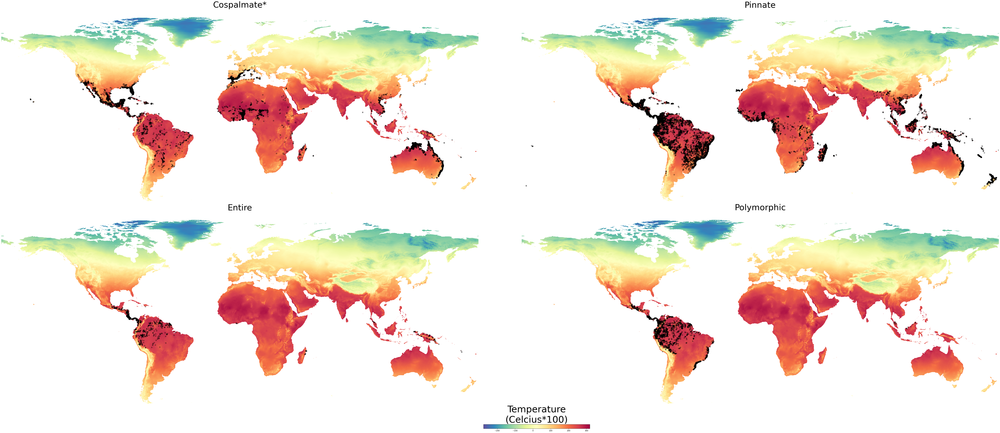

Temperature seasonality
(Standard Deviation*100)


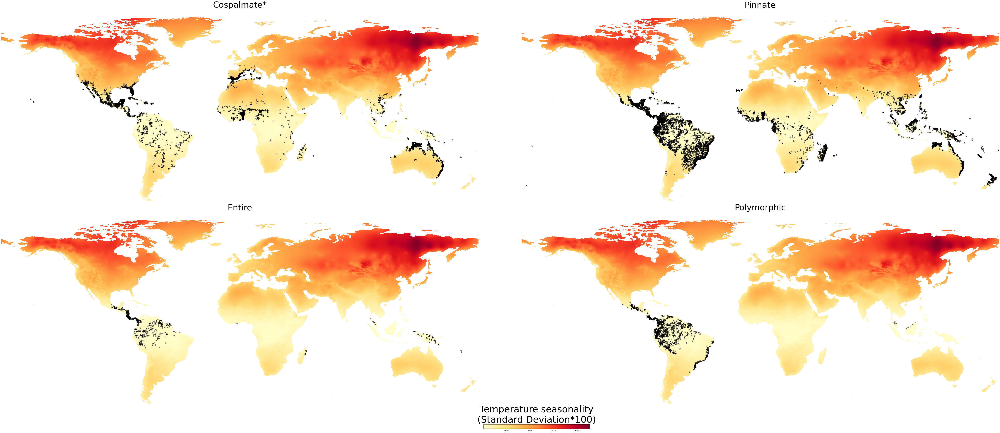

Precipitation log(mm)


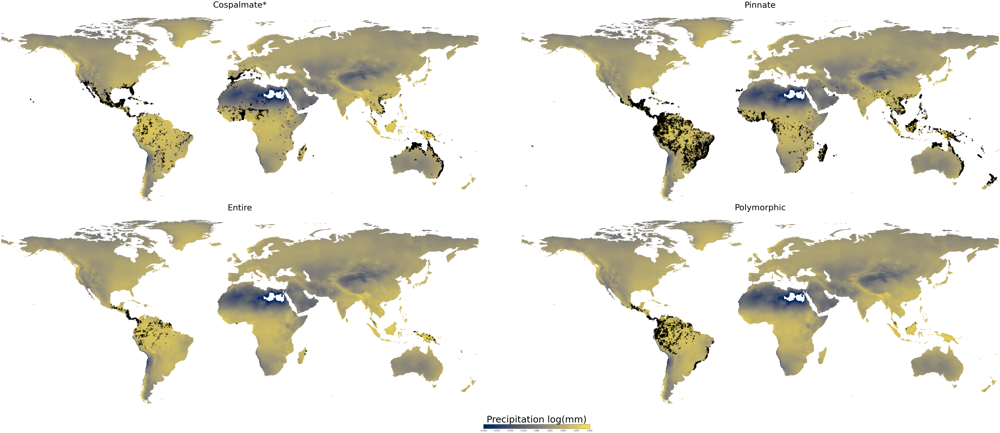

Precipitation seasonality
log(Coefficient of Variation mm)


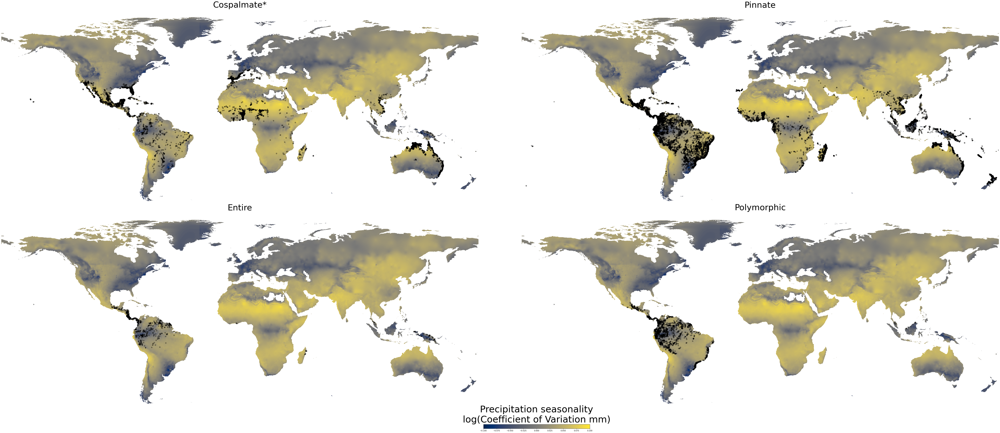

Aridity
log(Prec/(Temp+10))


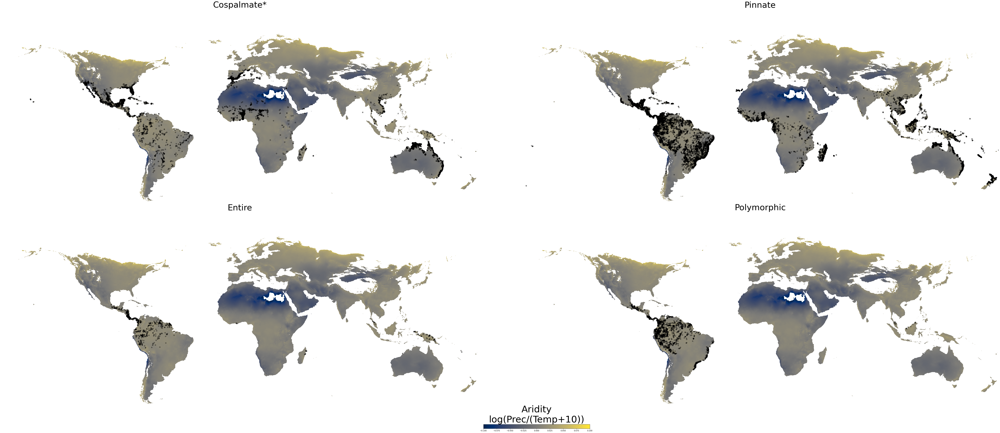

In [19]:
for ii in range(0,5,1): # for each of the five climatic variables
# ii=0
    fig=plt.figure(figsize=(100,40),facecolor='w') #width height
    outer_grid=gridspec.GridSpec(2,2, wspace=0.02, hspace=0.02) #row columns
    outer_grid.tight_layout(fig,rect=[0, 0.04, 1, 0.96]) #rect=[0, 0.03, 1, 0.95]

    # list(shape_text_dict.keys())
    print(var_name_list[ii])
    for j,(c,d) in enumerate(product(range(0,2),repeat=2)):
        ax=plt.subplot(outer_grid[c,d])# row column
#         sns.heatmap(raster_list[ii],cmap=cmap_list[ii],ax=ax,cbar=False) # True,cbar_kws=dict(use_gridspec=False,location='bottom',shrink=0.1)
        ax.imshow(raster_list[ii],cmap=cmap_list[ii])

        if d < 1:
            temp=intree[intree['species'].isin(shape_listdict[list(shape_text_dict.keys())[c]])]
            longs=(temp['decimalLongitude']+180)/xcell
            lats=(3600-(temp['decimalLatitude']+60)/ycell)
            ax.scatter(longs,lats,marker='.',s=100,edgecolor='k',facecolor='none')
            plt.title(shape_text_dict[(list(shape_text_dict.keys())[c])],size=45)
        else:
            temp=intree[intree['species'].isin(shape_listdict[list(shape_text_dict.keys())[c+2]])]
            longs=(temp['decimalLongitude']+180)/xcell
            lats=(3600-(temp['decimalLatitude']+60)/ycell)
            ax.scatter(longs,lats,marker='.',s=100,edgecolor='k',facecolor='none')
            plt.title(shape_text_dict[(list(shape_text_dict.keys())[c+2])],size=45)

        [ax.spines[loc].set_visible(False) for loc in ['top','right','left','bottom']]
        ax.set_xticklabels([]) ; ax.set_yticklabels([])
        plt.tick_params(axis='both',which='both',bottom=False,top=False,left=False,right=False,labelbottom=False)
    
    vmin=np.amin(raster_list[ii].min())
    vmax=np.amax(raster_list[ii].max())
    
    axcb=fig.add_axes([0.5,0.09, 0.08, 0.008], frame_on=False) # left(leftx) | bottom | width | height
    cb=mpl.colorbar.ColorbarBase(axcb,cmap=cmap_listcmap[ii],
                                 norm=mpl.colors.Normalize(vmin=vmin,vmax=vmax),
                                 orientation='horizontal',alpha=1.0,drawedges=False) # facecolors='none', edgecolors='r'
    axcb.xaxis.set_label_position('top')
    axcb.set_xlabel(var_name_list[ii],size=50)
    axcb.xaxis.labelpad=10
    axcb.tick_params(axis='y',which='both',direction='out',size=60,width=1,pad=10)
    plt.setp(axcb.get_yticklabels(),size=60)
    for tick in axcb.yaxis.get_ticklines():
        tick.set_markersize(60)

#     plt.savefig('../data_files/Figure_mapsshapesbio%s_20210211.pdf'%(ii),dpi=300)
    plt.show()

In [20]:
morphovar=['maxleaf_map','maxrachis_map','maxpalmsize_map','canopy_map']
cmap=mpl.cm.viridis

for var in morphovar:
    mini=min(intree[var].dropna().unique().astype('float'))
    maxi=max(intree[var].dropna().unique().astype('float'))
    norm=mpl.colors.Normalize(vmin=mini, vmax=maxi)
    #variable to colour
    coldic=dict(zip(intree[var].dropna().unique(),[cmap(norm(num)) for num in intree[var].dropna().unique()]))
    coldic[np.nan]='#ffffff'
    coldic['check_manually']='#ffffff'
    #species to variable
    spp_tocol=dict(zip(intree['species'],intree[var].map(coldic)))
    # creates column with color for the scatterplot
    intree['%s_col'%(var)]=intree['species'].map(spp_tocol)
intree
morpholabels=['Log Max leaf number','Max rachis length (log(m))','Palm size (log(m))','Understory/Canopy']

ipykernel_launcher.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  from ipykernel import kernelapp as app


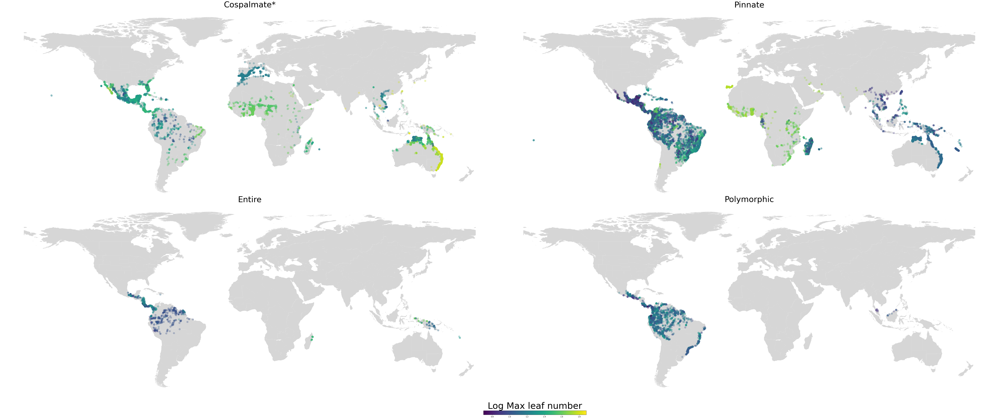

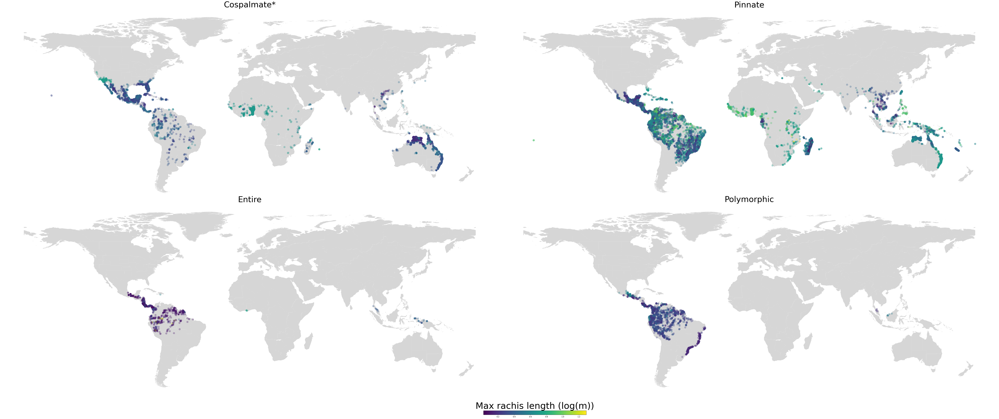

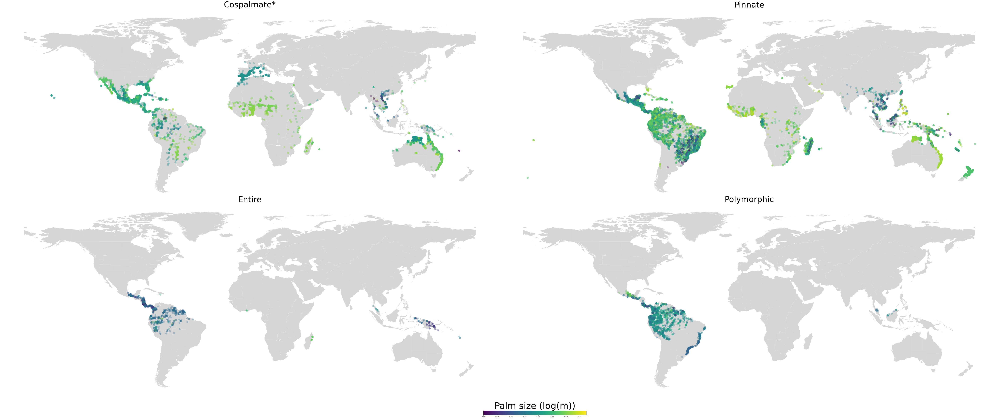

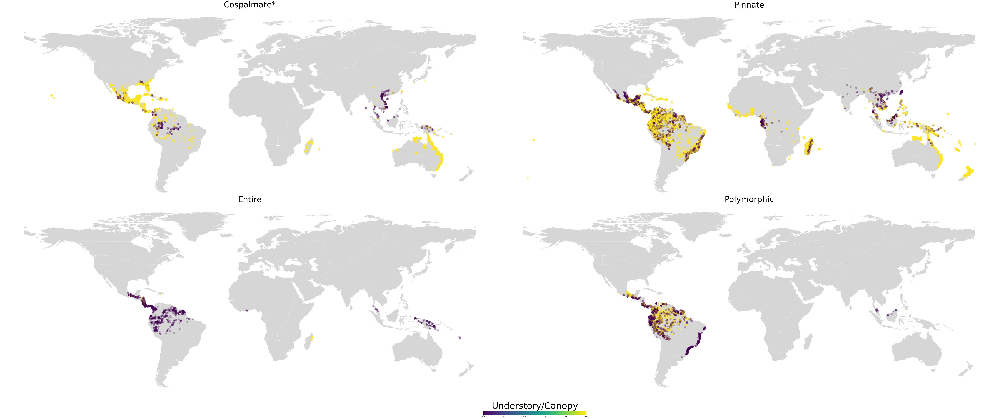

In [22]:
for ii in range(0,4,1):
    fig=plt.figure(figsize=(100,40),facecolor=None) #width height
    outer_grid=gridspec.GridSpec(2,2, wspace=0.005, hspace=0.005) #row columns
    outer_grid.tight_layout(fig,rect=[0, 0.04, 1, 0.96]) #rect=[0, 0.03, 1, 0.95]
    cmap=mpl.cm.viridis

    plt.rcParams['ytick.labelsize'] = 2
    plt.rcParams['ytick.labelsize'] = 2
    for j,(c,d) in enumerate(product(range(0,2),repeat=2)):
        ax=plt.subplot(outer_grid[c,d])# row column

        for loc in polygons.keys():
            if loc in total_area.keys() and 2 < total_area[loc] < 670:
                ax.add_collection(PatchCollection(polygons[loc],facecolor='#d6d6d6',edgecolor='#d6d6d6',alpha=1,linewidth=0.2))
        ax.plot()
        if d < 1:
            temp=intree[(intree['species'].isin(shape_listdict[list(shape_text_dict.keys())[c]])) & (intree[morphovar[ii]].isna()==False)]
            ax.scatter(temp['decimalLongitude'],temp['decimalLatitude'],marker='o',s=100,edgecolor=temp['%s_col'%(morphovar[ii])],facecolor=temp['%s_col'%(morphovar[ii])],alpha=0.3)
            plt.title(shape_text_dict[(list(shape_text_dict.keys())[c])],size=45)
        else:
            temp=intree[(intree['species'].isin(shape_listdict[list(shape_text_dict.keys())[c+2]])) & (intree[morphovar[ii]].isna()==False)]
            ax.scatter(temp['decimalLongitude'],temp['decimalLatitude'],marker='o',s=100,edgecolor=temp['%s_col'%(morphovar[ii])],facecolor=temp['%s_col'%(morphovar[ii])],alpha=0.3)
            plt.title(shape_text_dict[(list(shape_text_dict.keys())[c+2])],size=45)
        [ax.spines[loc].set_visible(False) for loc in ['top','right','left','bottom']]
        ax.set_xticklabels([]) ; ax.set_yticklabels([])
        plt.tick_params(axis='both',which='both',bottom=False,top=False,left=False,right=False,labelbottom=False)


    axcb=fig.add_axes([0.5,0.09, 0.08, 0.008], frame_on=False) # left(leftx) | bottom | width | height
    cb=mpl.colorbar.ColorbarBase(axcb,cmap=cmap,
                                 norm=mpl.colors.Normalize(vmin=intree[morphovar[ii]].replace('check_manually',np.nan).dropna().astype('float').min(),vmax=intree[morphovar[ii]].replace('check_manually',np.nan).dropna().astype('float').max()),
                                 orientation='horizontal',alpha=1.0,drawedges=False) # facecolors='none', edgecolors='r'
    axcb.xaxis.set_label_position("top")
    axcb.set_xlabel('%s'%(morpholabels[ii]),size=50)
    axcb.xaxis.labelpad=10
    axcb.tick_params(axis='y',which='both',direction='out',size=60,width=1,pad=10)
    plt.setp(axcb.get_yticklabels(),size=60)
    for tick in axcb.yaxis.get_ticklines():
        tick.set_markersize(60)
#     plt.savefig('../data_files/Figure_mapsshapesmorpho%s_20200630.png'%(ii),dpi=300)
    plt.show()